In [13]:
#Check for packages and install 
import subprocess
import sys

def install_and_import(package):
    try:
        __import__(package)
        print(f"{package} is already installed.")
    except ImportError:
        print(f"{package} not found, installing now...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", package])
        __import__(package)

# List of required packages
required_packages = [
    'pandas',
    'yfinance',
    'matplotlib',
    'seaborn',
    'plotly',
    'numpy'
]

# Apply the function to each required package
for package in required_packages:
    install_and_import(package)

pandas is already installed.
yfinance is already installed.
matplotlib is already installed.
seaborn is already installed.
plotly is already installed.
numpy is already installed.


In [1]:
#Import the required libraries
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

In [2]:
# Define assets by category
assets = {
    'Stock Indices': ["VTI", "EEM", "^GSPC", "^DJI","^GDAXI","^BVSP", "^IXIC", "^FTSE", "^FCHI", "^STOXX50E", "^N225", "^HSI", "^KS11", "^AXJO", "^GSPTSE", "^BSESN"],
    'Global Markets': ["EWA", "EWZ","EWC", "ASHR", "EWQ", "EWG","EWH","PIN", "EWI", "EWJ", "EWW", "EWP","EIS","EWU", "EFA", "IOO", "BKF", "CWI"],
    'US Equity Sectors': ["IVW","IVE","RSP","DVY","XLY", "XLP", "XLE", "XLF", "XLV", "XLI", "XLB", "XLK", "XLC", "XLU"],
    'US Government Bonds': ["IEF","TLT","AGG","BND","TIP","^IRX", "^FVX", "^TNX", "^TYX"],
    'Commodities': ["DBC","DBA","USO","UNG","GLD","SLV","GC=F", "MGC=F", "SI=F", "PL=F", "HG=F", "CL=F", "NG=F", "RB=F", "ZC=F", "BZ=F", "ZS=F", "ZC=F"],
    'Futures' : ["ES=F", "NQ=F", "RTY=F", "YM=F", "ZB=F", "ZT=F", "ZF=F", "ZN=F"],
    'FX': ["JPY=X", "GBPUSD=X", "AUDUSD=X", "NZDUSD=X","EURUSD=X", "EURJPY=X", "EURCAD=X","EURCHF=X", "GBPJPY=X",
           "EURGBP=X", "GBPUSD=X", "USDSGD=X", "USDMXN=X", "EURAUD=X", "USDTRY=X"],
    'Volatility Index': ["^VIX","^OVX", "^VIX1D", "^VIX3M", "^EVZ", "^GVZ", "^OVX"]
}

In [3]:
# Fetch historical stock data from Yahoo Finance
start_date = "2023-01-01"
end_date = "2023-11-01"
data = {}
for category, tickers in assets.items():
    data[category] = {ticker: yf.download(ticker, start=start_date, end=end_date)['Adj Close'] for ticker in tickers}

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

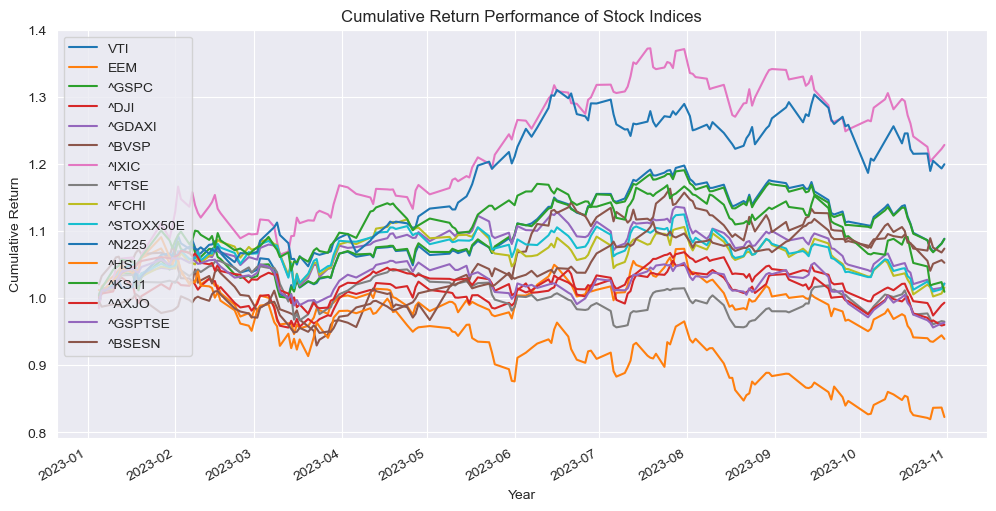

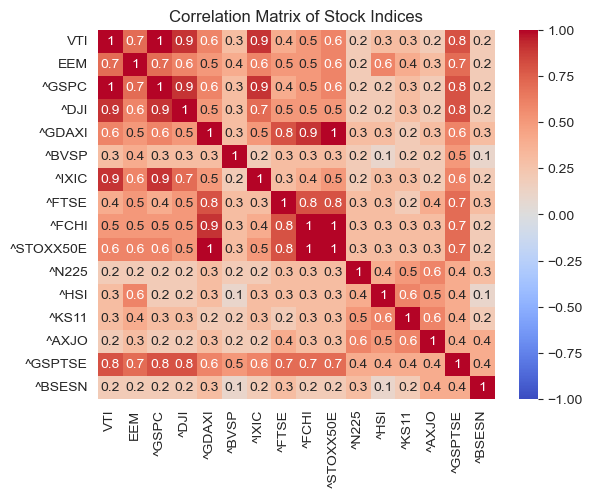

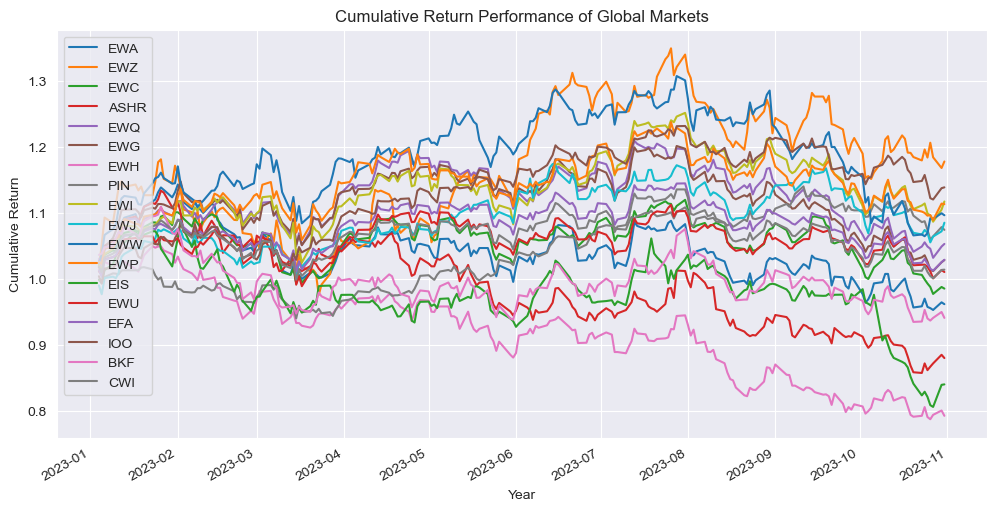

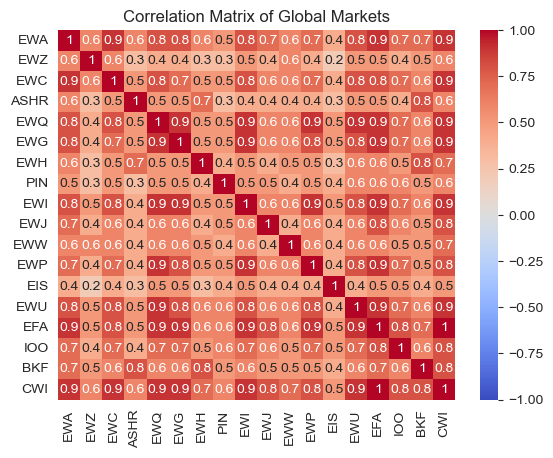

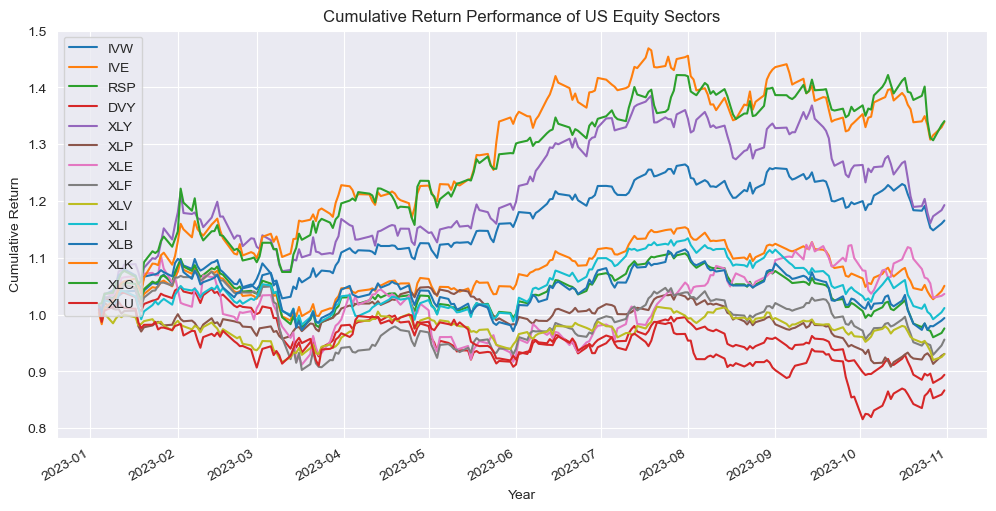

...

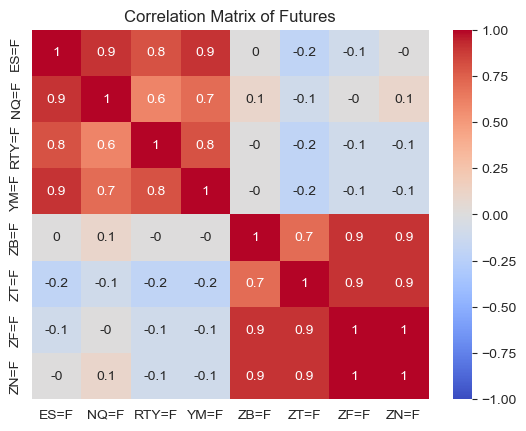

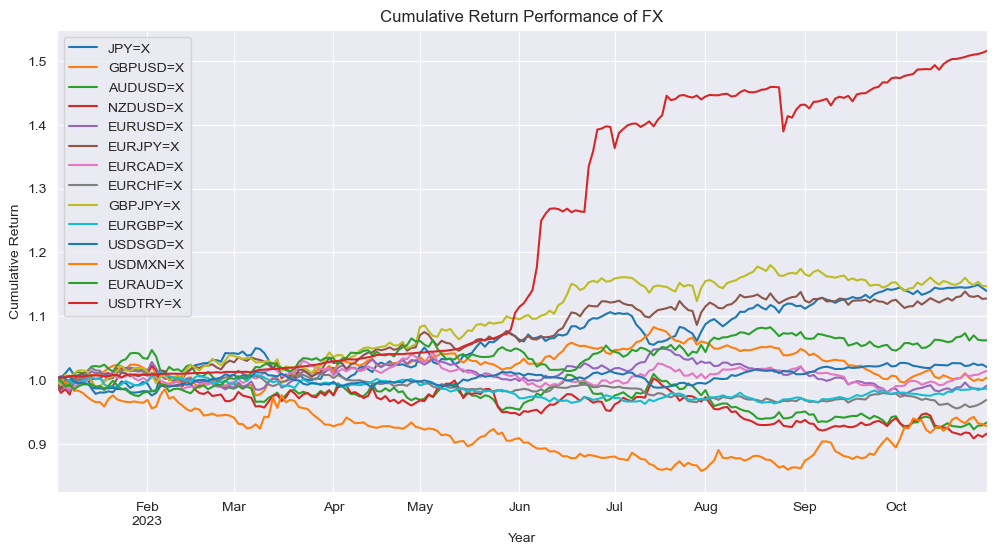

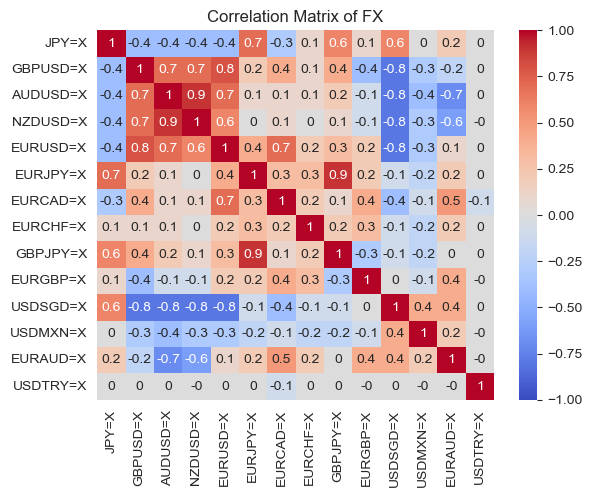

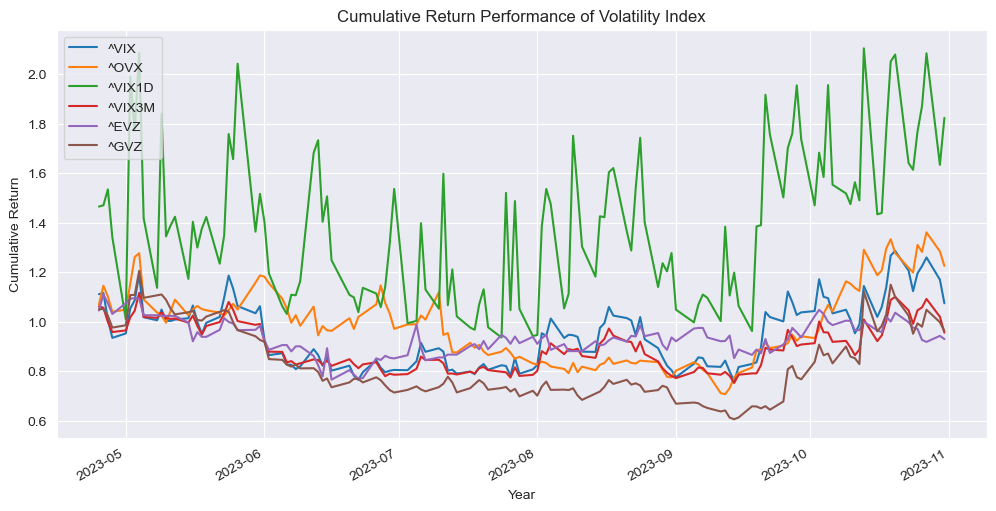

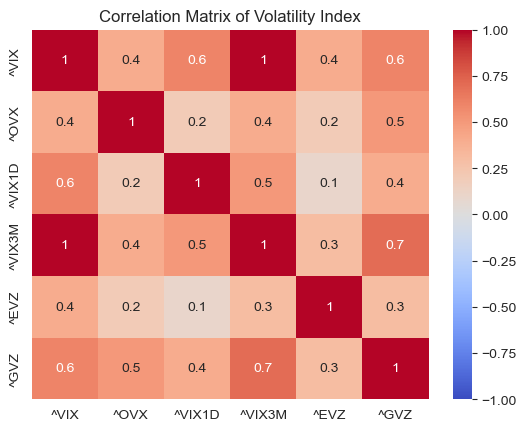

In [8]:
#Function to compute MACD
def compute_macd(data, span1=12, span2=26, signal=9):
    exp1 = data.ewm(span=span1, adjust=False).mean()
    exp2 = data.ewm(span=span2, adjust=False).mean()
    macd = exp1 - exp2
    signal_line = macd.ewm(span=signal, adjust=False).mean()
    return macd, signal_line
# Process and plot data for each category
for category, datasets in data.items():
    df = pd.DataFrame(datasets).dropna()
    daily_returns = df.pct_change().dropna()
    cumulative_returns = (1 + daily_returns).cumprod()
    
    #Plot Cumulative Return Performance
    cumulative_returns.plot(figsize=(12, 6), title=f"Cumulative Return Performance of {category}")
    plt.ylabel("Cumulative Return")
    plt.xlabel("Year")
    plt.legend(loc="upper left")
    plt.grid(True)
    plt.show()
    # Plot correlation matrix if more than one ticker in the category
    if len(datasets) > 1:
        corr_matrix = daily_returns.corr().round(1)
        sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
        plt.title(f"Correlation Matrix of {category}")
        plt.show()

In [9]:
# Function to compute Bollinger Bands
def compute_bollinger_bands(data, window=20, no_of_std=2):
    rolling_mean = data.rolling(window=window).mean()
    rolling_std = data.rolling(window=window).std()
    upper_band = rolling_mean + (rolling_std * no_of_std)
    lower_band = rolling_mean - (rolling_std * no_of_std)
    return upper_band, lower_band, rolling_mean

# Process and plot data for each category
for category, datasets in data.items():
    for ticker in datasets:
        fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.02, row_heights=[0.7, 0.3])

        # Price with Bollinger Bands
        upper_band, lower_band, rolling_mean = compute_bollinger_bands(datasets[ticker])
        fig.add_trace(go.Scatter(x=datasets[ticker].index, y=datasets[ticker], name='Price', line=dict(color='blue')), row=1, col=1)
        fig.add_trace(go.Scatter(x=datasets[ticker].index, y=upper_band, name='Upper Band', line=dict(color='red')), row=1, col=1)
        fig.add_trace(go.Scatter(x=datasets[ticker].index, y=lower_band, name='Lower Band', line=dict(color='green')), row=1, col=1)
        fig.add_trace(go.Scatter(x=datasets[ticker].index, y=rolling_mean, name='Moving Average', line=dict(color='purple', dash='dash')), row=1, col=1)

        # MACD
        macd, signal_line = compute_macd(datasets[ticker])
        fig.add_trace(go.Scatter(x=datasets[ticker].index, y=macd, name='MACD', line=dict(color='orange')), row=2, col=1)
        fig.add_trace(go.Scatter(x=datasets[ticker].index, y=signal_line, name='Signal Line', line=dict(color='black', dash='dot')), row=2, col=1)

        fig.update_layout(title_text=f"{ticker} Price, Bollinger Bands, and MACD", height=600)
        fig.show()

# Compute Sharpe Ratio (Assuming risk-free rate is 0 for simplicity)
for category, datasets in data.items():
    stats = pd.DataFrame(index=["Mean", "Standard Deviation", "Sharpe Ratio"])
    daily_returns = pd.DataFrame(datasets).pct_change().dropna()
    for ticker in datasets:
        stats[ticker] = [
            daily_returns[ticker].mean(),
            daily_returns[ticker].std(),
            daily_returns[ticker].mean() / daily_returns[ticker].std() if daily_returns[ticker].std() != 0 else np.nan
        ]
    print(f"\nStatistical Data for {category}:\n")
    print(stats)
    print("\n" + "-" * 50 + "\n")


Statistical Data for Stock Indices:

                         VTI       EEM     ^GSPC      ^DJI    ^GDAXI  \
Mean                0.000435 -0.000247  0.000431 -0.000004  0.000137   
Standard Deviation  0.008575  0.009434  0.008361  0.007239  0.008347   
Sharpe Ratio        0.050690 -0.026221  0.051540 -0.000620  0.016379   

                       ^BVSP     ^IXIC     ^FTSE     ^FCHI  ^STOXX50E  \
Mean                0.000390  0.001026 -0.000138  0.000115   0.000144   
Standard Deviation  0.010624  0.011219  0.007374  0.008939   0.009201   
Sharpe Ratio        0.036739  0.091419 -0.018720  0.012823   0.015613   

                       ^N225      ^HSI     ^KS11     ^AXJO   ^GSPTSE    ^BSESN  
Mean                0.000899 -0.000821  0.000083 -0.000166 -0.000150  0.000259  
Standard Deviation  0.009704  0.013392  0.008656  0.006671  0.006878  0.005989  
Sharpe Ratio        0.092647 -0.061289  0.009556 -0.024863 -0.021842  0.043311  

--------------------------------------------------


St

In [10]:
def get_insights(datasets):
    insights = {}
    for category, data in datasets.items():
        daily_returns = pd.DataFrame(data).pct_change()
        avg_returns = daily_returns.mean().sort_values(ascending=False)
        high_volatility = daily_returns.std().sort_values(ascending=False)
        top_performers = avg_returns.head(3).index.tolist()
        most_volatile = high_volatility.head(3).index.tolist()
        insights[category] = {'Top Performers': top_performers, 'Most Volatile': most_volatile}
    return insights

In [12]:
##Data shortlisting

selected_category = input("Enter category separated by comma ('Stock Indices, Global Markets, US Equity Sectors, US Government Bonds, Commodities, Futures, FX, Volatility'): ").split(',')
selected_assets = input("Enter assets separated by comma (e.g., 'VTI,EEM'): ").split(',')

start_date = input("Enter start date (YYYY-MM-DD): ")
end_date = input("Enter end date (YYYY-MM-DD): ")

# Fetch data only for selected assets
selected_data = {ticker: yf.download(ticker, start=start_date, end=end_date)['Adj Close'] for ticker in selected_assets}
#Save a excel copy of data
with pd.ExcelWriter('market_data.xlsx') as writer:
    for category, datasets in data.items():
        for ticker, df in datasets.items():
            df.to_excel(writer, sheet_name=f"{category}_{ticker}")

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
